# Non-minimax Method for Averaging Color Palettes
**GPU-only implementation.**

In [1]:
import matplotlib
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
from mpl_toolkits.mplot3d import Axes3D

from tqdm import tqdm, tqdm_notebook

import warnings
warnings.filterwarnings('ignore')
from IPython.display import clear_output

import os, sys
sys.path.append("..")

import torch
from torch import nn
from torch.nn import functional as F

from scipy.stats import ortho_group
from scipy.linalg import sqrtm

from src.icnn import DenseICNN
from src.plotters import plot_rgb_cloud, plot_training_phase_palettes, plot_training_phase_im
from src.tools import ewma
from src import distributions
from src import benchmarks
import itertools
import time
import pandas as pd
from PIL import Image

from sklearn.decomposition import PCA

from copy import deepcopy

In [2]:
GPU_DEVICE = 1
ALPHAS = np.array([0.33333, 0.33333, 0.33333])

In [3]:
DIM = 3
assert DIM == 3

WANDB_LOG = False
OUTPUT_SEED = 0xBADBEEF

BATCH_SIZE = 2048

LAMBDA = 10
R_LAMBDA = 100
D_LR = 1e-4
MAX_ITER = 10001

PLOT_FREQ = 999
SCORE_FREQ = 100

INPUTS = [
    '../data/color_transfer/forest_road.jpg',
    '../data/color_transfer/green_forest.jpg',
    '../data/color_transfer/blue_sunset.jpg',
]

NUM = len(INPUTS)

# Parameters for input distributions
# ALPHAS = np.array([1. / NUM for _ in range(NUM)])assert NUM == len(ALPHAS)
ALPHAS = np.array(ALPHAS)
NAME = f'NMM__SHAPES_NUM={NUM}_DIM={DIM}_C={LAMBDA}_R={R_LAMBDA}_{OUTPUT_SEED}'

# Log to online wandb?
WANDB_CONFIG = {
    'name' : NAME,
    'entity' : "gunsandroses", 
    'project' : "bar-methods-comparison",
}

if WANDB_LOG:
    import wandb
    from src.tools import fig2img
    wandb.init(
        **WANDB_CONFIG,
        config={
            'CASE' : CASE,
            'OUTPUT_SEED' : OUTPUT_SEED,
            'DIM' : DIM,
            'NUM' : NUM,
            'ALPHAS' : ALPHAS,
            "D_LR" : D_LR,
            'BATCH_SIZE' : BATCH_SIZE,
            'LAMBDA' : LAMBDA,
            'R_LAMBDA' : LAMBDA,
        }
    )

## Initializing distributions

In [4]:
assert torch.cuda.is_available()
torch.cuda.set_device(GPU_DEVICE)

np.random.seed(OUTPUT_SEED)
torch.manual_seed(OUTPUT_SEED)

100%|██████████| 3/3 [00:02<00:00,  1.25it/s]


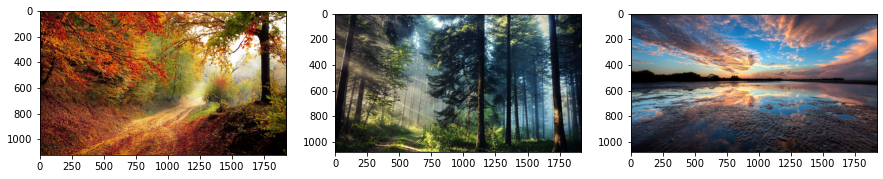

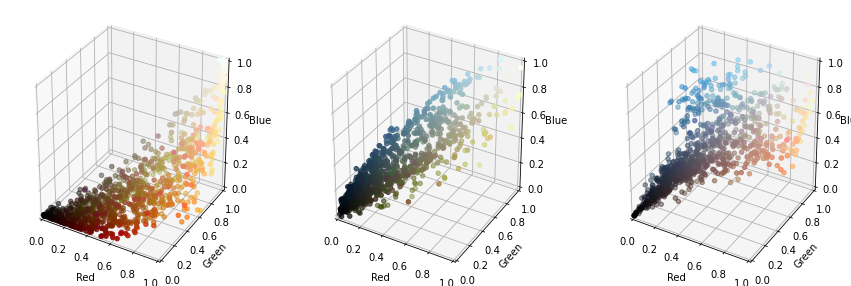

In [5]:
fig_im, axes_im = plt.subplots(1, NUM, figsize=(NUM*5, 5))
fig_p, axes_p = plt.subplots(1, NUM, figsize=(NUM*5, 5), subplot_kw=dict(projection='3d'))
samplers = []
imgs = []

for n in tqdm(range(NUM)):
    im = Image.open(INPUTS[n]).convert('RGB')
    imgs.append(im)
    axes_im[n].imshow(im)
    sampler = distributions.TensorDatasetSampler(
        (np.asarray(im).transpose(2, 0, 1).reshape(3, -1) / 255.).T,
        requires_grad=True
    )
    plot_rgb_cloud(sampler.sample(1024).cpu().detach().numpy(), axes_p[n])

    samplers.append(sampler)

benchmark = benchmarks.Wasserstein2BarycenterBenchmark(samplers, requires_grad=True, device='cuda')

## Discriminators Setup

In [7]:
D = DenseICNN(
    DIM, rank=3, hidden_layer_sizes=[max(256, 2*DIM), max(256, 2*DIM), max(256, DIM)],
    dropout=0.01, strong_convexity=0, activation='relu'
).cuda()

print(np.sum([np.prod(list(p.shape)) for p in D.parameters()]), 'parameters in Discriminative Network')

# Manual weights init
for p in D.parameters():
    p.data = torch.randn(p.shape, device='cuda', dtype=torch.float32) / 2.

141312 parameters in Discriminative Network


In [8]:
X0_sampler = distributions.CubeUniformSampler(dim=DIM, requires_grad=True)
D_opt = torch.optim.Adam(D.parameters(), lr=1e-3, betas=(0.8, 0.9), weight_decay=1e-7)

D.train(True)
loss = np.inf

for iteration in tqdm(range(10000)):
    X = (((X0_sampler.sample(BATCH_SIZE)) - 0.5) * 4 + 0.5).detach()
    X.requires_grad_(True)

    loss = F.mse_loss(D.push(X), X.detach())
    loss.backward()
    D_opt.step(); D_opt.zero_grad()
    D.convexify()
    
    if loss.item() < 1e-4:
        break
    
    if iteration % 500 == 0:
        clear_output(wait=True)
        print('Pretraining the discriminator for D.push(x)=x')
        print('Current loss:', loss.item())
        
print('Final Loss:', loss.item())

 95%|█████████▌| 9518/10000 [01:24<00:03, 123.45it/s]

Pretraining the discriminator for D.push(x)=x
Current loss: 0.0006479103467427194


100%|██████████| 10000/10000 [01:28<00:00, 113.47it/s]

Final Loss: 0.0005883014528080821


In [9]:
D_list = nn.ModuleList([deepcopy(D) for _ in range(benchmark.num)]).cuda()
D_conj_list = nn.ModuleList([deepcopy(D) for _ in range(benchmark.num)]).cuda()

## Main training

In [10]:
D_opt = torch.optim.Adam(
    D_list.parameters(), lr=D_LR,
    betas=(0.8, 0.99), weight_decay=1e-8
)
D_conj_opt = torch.optim.Adam(
    D_conj_list.parameters(), lr=D_LR,
    betas=(0.4, 0.4), weight_decay=1e-8
)

loss_history = []
time_elapsed = []
full_log = {}

if hasattr(benchmark, 'gauss_bar_cost'):
    print('Gaussian Barycenter Cost:', benchmark.gauss_bar_cost)
    
if hasattr(benchmark, 'bar_cost'):
    print('Barycenter Cost:', benchmark.bar_cost)

Gaussian Barycenter Cost: 0.3786619418460706
Barycenter Cost: None


(<Figure size 3000x3000 with 9 Axes>,
 array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7f9cc06b9690>,
       dtype=object))

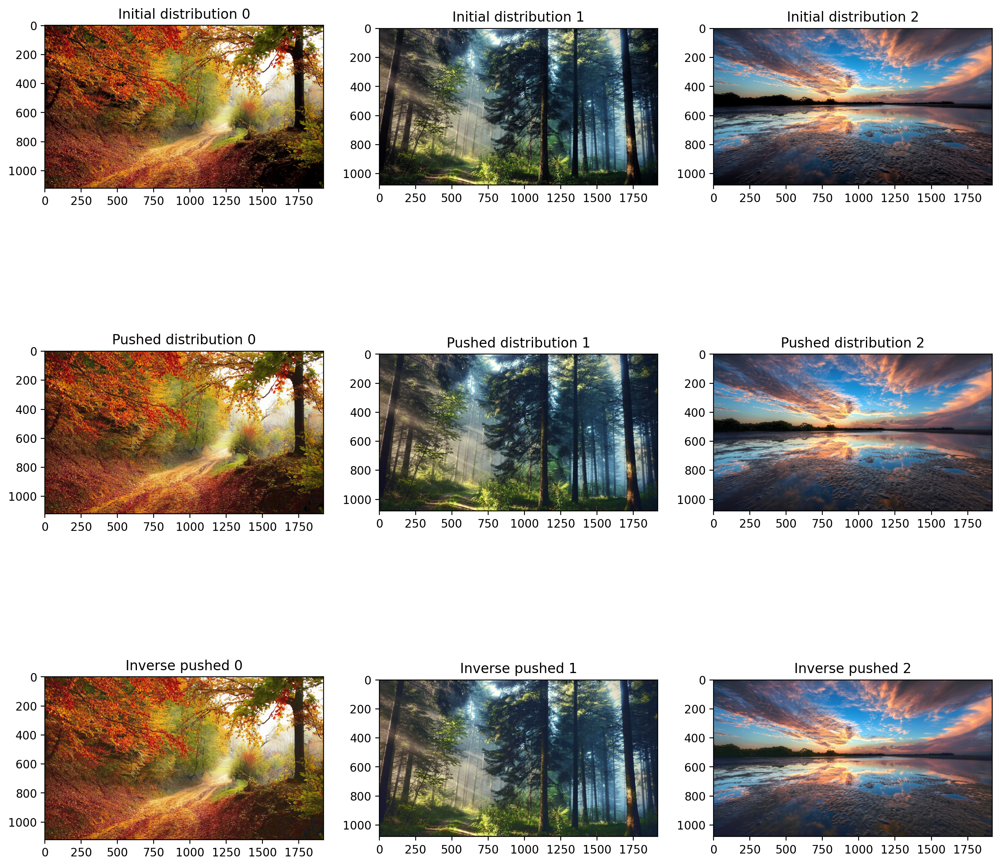

In [11]:
proposed_sampler = benchmark.gauss_bar_sampler
it = 0
plot_training_phase_im(imgs, D_list, D_conj_list, plot_batchsize=1024)

Iteration 9991


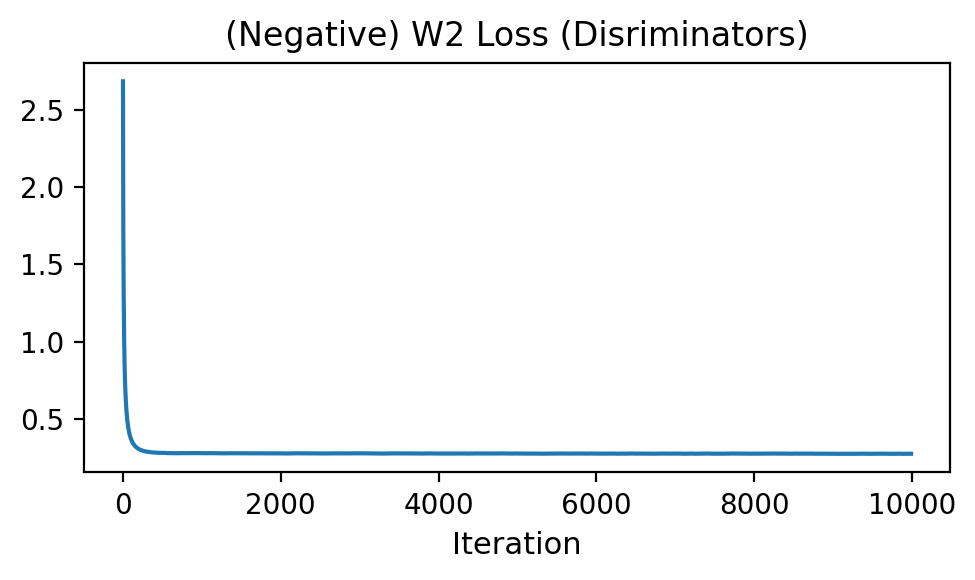

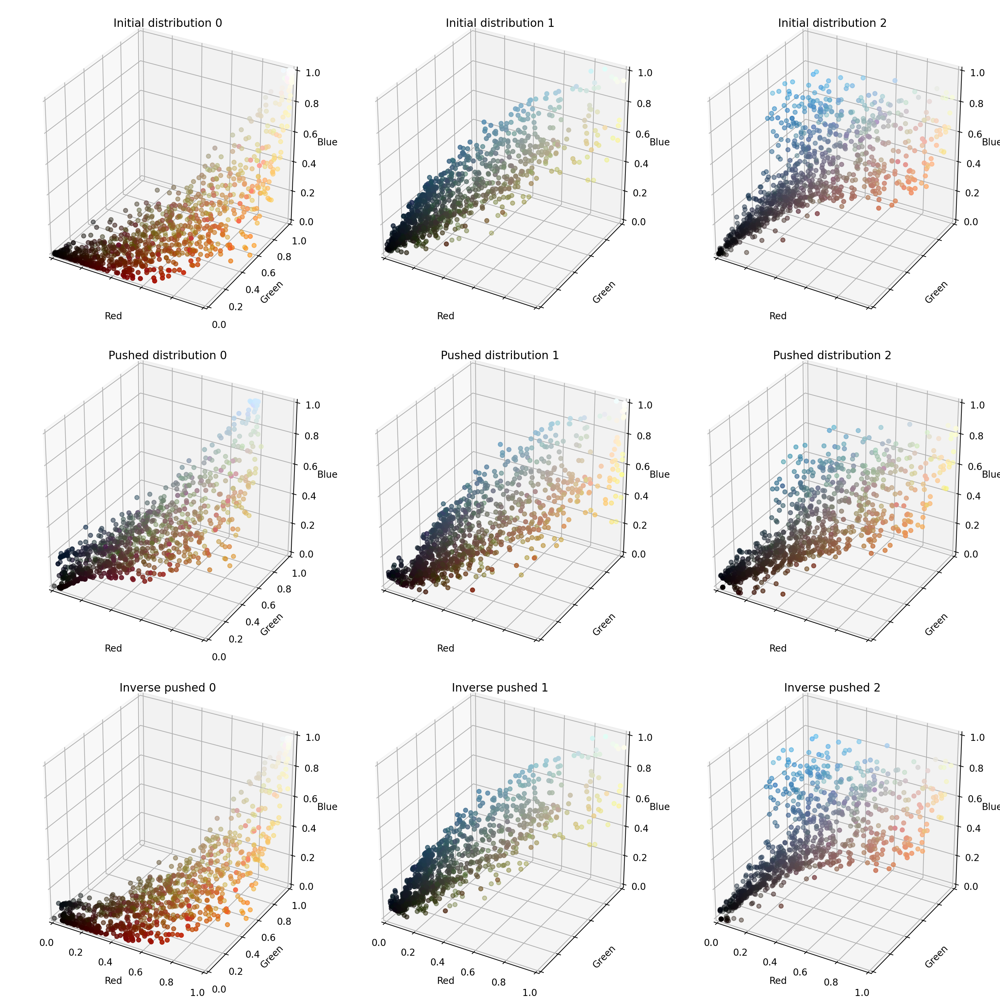

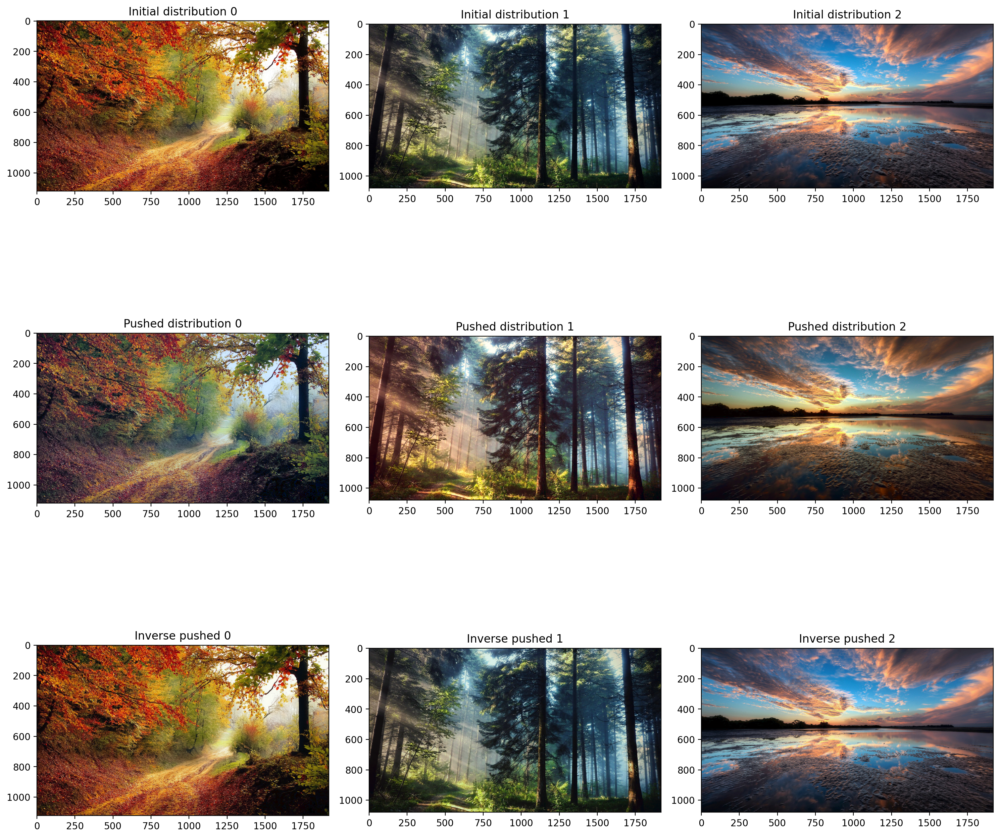

In [12]:
last_plot_it = -999

while it < MAX_ITER:
    it += 1
    start_time = time.time()
    D_list.train(True); D_conj_list.train(True); 
    loss = 0.
    
    for n in range(benchmark.num):
        X = benchmark.samplers[n].sample(BATCH_SIZE)
        X_inv = D_list[n].push(X).detach()
        loss += benchmark.alphas[n] * ((X_inv * X).sum(dim=1).reshape(-1, 1) - D_conj_list[n](X_inv)).mean()
    
    log = {'pure_loss' : loss.item()}
    
    # Cycle Loss
    cycle_loss = 0.
    for n in range(benchmark.num):
        X = benchmark.samplers[n].sample(BATCH_SIZE)
        
        # Cycle loss
        cycle_loss += benchmark.alphas[n] * ((D_conj_list[n].push(D_list[n].push(X)) - X.detach()) ** 2).mean()

    loss += LAMBDA * cycle_loss
    
    # Congruence Regularization Loss
    reg_loss = 0.
    
    Y = torch.cat(
        [proposed_sampler.sample(BATCH_SIZE).detach()] +
        [D_list[n].push(benchmark.samplers[n].sample(BATCH_SIZE)).detach() for n in range(benchmark.num)],
        dim=0
    ).detach()
    
    for n in range(benchmark.num):
        reg_loss += benchmark.alphas[n] * D_conj_list[n](Y)
    reg_loss -= ((Y ** 2).sum(dim=1) / 2).reshape(-1, 1)
    reg_loss = torch.relu(reg_loss).mean()
    
    loss += R_LAMBDA * reg_loss
    
    loss_history.append(loss.item())
    loss.backward()
    D_opt.step(); D_conj_opt.step()
    D_opt.zero_grad(); D_conj_opt.zero_grad(); 
    
    for n in range(benchmark.num):
        D_conj_list[n].convexify()
        D_list[n].convexify()
        
    time_elapsed.append(time.time() - start_time)
        
    log = {
        **log,
        'full_loss' : loss.item(),
        'cycle_loss_XYX' : cycle_loss.item(),
        'reg_loss' : reg_loss.item(),
        'time' : time_elapsed[-1],
    }        
        
    full_log[it] = log
    if WANDB_LOG:
        wandb.log(log, step=it)
    
    # Plotting
    if it - last_plot_it >= PLOT_FREQ:
        clear_output(wait=True)
        D_list.train(False); D_conj_list.train(False); 
        print('Iteration', it)
        last_plot_it = it        
        
        # Plotting Metrics
        fig, ax = plt.subplots(1, 1, figsize=(5, 3), dpi=200)
        ax.set_title('(Negative) W2 Loss (Disriminators)', fontsize=12)
        ax.set_xlabel('Iteration', fontsize=11)
        ax.plot(ewma(loss_history))

        fig.tight_layout(); plt.show(); plt.close(fig)
        
        # Plotting scatter plots
        fig, ax = plot_training_phase_palettes(benchmark, D_list, D_conj_list, plot_batchsize=1024)
        fig.tight_layout();
        
        if WANDB_LOG:
            wandb.log({'map' : [wandb.Image(fig2img(fig))]}, step=it)
            
        fig, ax = plot_training_phase_im(imgs, D_list, D_conj_list, plot_batchsize=1024)
        fig.tight_layout();
        
        if WANDB_LOG:
            wandb.log({'imgs' : [wandb.Image(fig2img(fig))]}, step=it)
        
        plt.show(); plt.close(fig)